## Project Goals
The Loan Default Prediction project addresses the critical challenge of assessing loan default risks for financial institutions. This initiative analyzes historical borrower data, including financial history, employment details, and past loan performance, to identify patterns and insights. The primary objective is to leverage machine learning to enhance decision-making, balance risk mitigation, and maximize lending opportunities while ensuring transparency and compliance.

Insights and recommendations are provided on the following key areas:

- Cost Analysis: Evaluating the financial impact of false positives (denying loans to creditworthy individuals) and false negatives (approving loans for likely defaulters).
- Bias and Fairness: Ensuring the model does not exhibit bias against protected attributes such as age or gender, maintaining compliance with regulatory requirements.
- Global and Local Model Interpretability: Utilizing SHAP values to understand feature importance at global and individual levels, aiding transparency for data scientists, stakeholders, and regulators.
- Explainability Methods: Apply techniques such as anchors and counterfactuals to provide clear, rule-based explanations for model predictions and address the concerns of stakeholders and regulators.

****
About Data
****
| Column Name          | Data Type                | Description                   |
|----------------------|--------------------------|-------------------------------|
| User id              | Integer                  | Unique user identifier        |
| Loan category        | String                   | Categorical variable          |
| Amount               | Integer                  | Loan amount                   |
| Interest Rate        | Integer                  | Interest rate                 |
| Tenure               | Integer                  | Loan tenure                   |
| Employment type      | String                   | Categorical variable          |
| Tier of Employment   | Categorical and Ordinal  | Employment tier classification|
| Industry             | Categorical              | Industry type                 |
| Role                 | Categorical              | Role description              |
| Work Experience      | Categorical and Ordinal  | Work experience category      |
| Total Income(PA)     | Integer                  | Total annual income           |
| Gender               | Categorical              | Gender of the user            |
| Married              | Categorical              | Marital status                |
| Dependents           | Integer                  | Number of dependents          |
| Home                 | Categorical              | Housing category              |
| Pincode              | Unknown                  | Pincode information           |
| Social Profile       | Categorical              | Social profile of the user    |
| Is_verified          | Categorical              | Verification status           |
| Delinq_2yrs          | Integer                  | Number of delinquencies       |
| Total Payment        | Integer                  | Total payment received        |
| Received Principal   | Integer                  | Principal amount received     |
| Interest Received    | Integer                  | Interest amount received      |
| Number of loans      | Integer                  | Number of loans taken          |
| Defaulter            | Categorical              | Loan defaulter classification |

****
**Target Column to be predicted "Defaulter"**

## import libraries

In [1]:
import pandas as pd
import numpy as np
import os
import warnings
warnings.filterwarnings('ignore')

In [2]:
def read_excel_data(file_path, sheet_names):
    data_frames = []

    # Read each sheet from the Excel file and store it in a list of DataFrames
    for sheet_name in sheet_names:
        data_frame = pd.read_excel(file_path, sheet_name=sheet_name, engine='openpyxl')
        data_frames.append(data_frame)

    return data_frames

In [3]:
path = 'Credit_Risk_Dataset.xlsx'

# Call the function to read the Excel data
sheet_names= ['loan_information','Employment','Personal_information','Other_information']

loan_information, employment, personal_information, other_information = read_excel_data(path, sheet_names)


In [4]:
# Merge 'loan_information' and 'Employment' dataframes based on 'User_id'
merged_df = pd.merge(loan_information, employment, left_on='User_id', right_on='User id')

# Merge the previously merged dataframe with 'personal_information' based on 'User_id'
merged_df = pd.merge(merged_df, personal_information, left_on='User_id', right_on='User id')

# Merge the previously merged dataframe with 'other_information' based on 'User_id'
merged_df = pd.merge(merged_df, other_information, left_on='User_id', right_on='User_id')

df=merged_df
# Display the first few rows of the merged dataframe
df.head()

,User_id,Loan Category,Amount,Interest Rate,Tenure(years),User id_x,Employmet type,Tier of Employment,Industry,Role,...,Home,Pincode,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
0,7013527,Consolidation,55884.0,11.84,6,7013527,Salaried,B,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGAZSEWdkcndwkcnCCM,...,rent,XX852X,No,NaN,0,1824.150000,971.46,852.69,0,1
1,7014291,Consolidation,55511.0,16.94,4,7014291,Self - Employeed,D,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNCSEWdkcndwkcnCCM,...,mortgage,XX286X,NaN,Source Verified,0,22912.532998,18000.00,4912.53,0,0
2,7014327,Consolidation,12289.0,11.84,6,7014327,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGNYSEWdkcndwkcnCCM,...,own,XX113X,No,NaN,0,7800.440000,4489.76,3310.68,0,1
3,7014304,Credit Card,29324.0,14.71,4,7014304,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX941X,Yes,NaN,0,6672.050000,5212.29,1459.76,0,0
4,7031995,Credit Card,30252.0,14.71,4,7031995,NaN,NaN,mLVIVxoGY7TUDJ1FyFoSIZi1SFcaBmO01AydRchaEiGYtU...,KHMbckjadbckIFGCASEWdkcndwkcnCCM,...,rent,XX913X,No,Verified,0,11793.001345,10000.00,1793.00,0,0


## EDA

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 143727 entries, 0 to 143726
Data columns (total 26 columns):
 #   Column              Non-Null Count   Dtype  
---  ------              --------------   -----  
 0   User_id             143727 non-null  int64  
 1   Loan Category       143727 non-null  object 
 2   Amount              111803 non-null  float64
 3   Interest Rate       143727 non-null  float64
 4   Tenure(years)       143727 non-null  int64  
 5   User id_x           143727 non-null  int64  
 6   Employmet type      59085 non-null   object 
 7   Tier of Employment  59085 non-null   object 
 8   Industry            143723 non-null  object 
 9   Role                143727 non-null  object 
 10  Work Experience     143723 non-null  object 
 11  Total Income(PA)    143727 non-null  float64
 12  User id_y           143727 non-null  int64  
 13  Gender              143727 non-null  object 
 14  Married             95584 non-null   object 
 15  Dependents          143727 non-nul

In [6]:
df.describe()

,User_id,Amount,Interest Rate,Tenure(years),User id_x,Total Income(PA),User id_y,Dependents,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter
count,1.437270e+05,1.118030e+05,143727.000000,143727.000000,1.437270e+05,1.437270e+05,1.437270e+05,143727.000000,143727.000000,143727.000000,143727.000000,143727.000000,143727.000000,143727.000000
mean,3.733474e+07,1.376458e+05,12.038703,4.514503,3.733474e+07,7.242256e+04,3.733474e+07,1.997113,0.276601,10840.882025,8407.001538,2352.729746,0.005573,0.093712
std,3.182811e+07,1.575427e+05,3.880204,0.874241,3.182811e+07,5.539328e+04,3.182811e+07,1.411317,0.789019,8613.421536,7224.396032,2447.759754,0.098785,0.291429
min,2.080360e+05,0.000000e+00,5.420000,4.000000,2.080360e+05,4.000000e+03,2.080360e+05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,3.276118e+06,2.837950e+04,9.180000,4.000000,3.276118e+06,4.500000e+04,3.276118e+06,1.000000,0.000000,4674.775000,3104.160000,841.685000,0.000000,0.000000
50%,5.766517e+07,7.660300e+04,11.840000,4.000000,5.766517e+07,6.180000e+04,5.766517e+07,2.000000,0.000000,8212.410000,6000.000000,1632.240000,0.000000,0.000000
75%,6.729174e+07,2.054645e+05,14.440000,6.000000,6.729174e+07,8.600000e+04,6.729174e+07,3.000000,0.000000,14175.769677,11664.365000,2904.770000,0.000000,0.000000
max,7.895894e+07,8.000078e+06,23.540000,6.000000,7.895894e+07,7.141778e+06,7.895894e+07,4.000000,22.000000,57777.579870,35000.010000,24205.620000,5.000000,1.000000


## Handling Missing Values


In [7]:
df.isnull().sum()

,0
User_id,0
Loan Category,0
Amount,31924
Interest Rate,0
Tenure(years),0
User id_x,0
Employmet type,84642
Tier of Employment,84642
Industry,4
Role,0


**Analysis: Handling Missing Values**
* Social profile: Create a new category for NA values.
* Is verified: Create a new category for NA values.
* Married: Create a new category for NA values.
* Industry: Consider dropping missing values.
* Work experience: Consider dropping missing values.
* Amount: Evaluate the impact of removing rows with missing values on the data distribution.
* Employment type: Determine the appropriate approach for handling missing values.
* Tier of employment: Determine the appropriate approach for handling missing values.

In [8]:
# Drop rows with missing values in the 'Industry' and 'Work Experience' columns as the data in 'Industry' is meaningless due to encryption, and 'Work Experience' is inconsistent in the dataset, treating it as an object datatype variable which may impact model performance.
df = df.dropna(subset=['Industry', 'Work Experience'])

In [9]:
def replace_null_values_with_a_value(df, columns,value):
    # Replace null values with "missing" in specific columns
    for column in columns:
        df[column] = df[column].fillna(value)
    return df

In [10]:
# Call the function to replace null values with "missing"
replace_with='missing'
columns_to_replace = ['Social Profile', 'Is_verified', 'Married', 'Employmet type']

df= replace_null_values_with_a_value(df, columns_to_replace, replace_with)

In [11]:
#Create a new variable "amount_missing" to indicate if the 'Amount' is missing or not. Assign 1 if 'Amount' is null, otherwise assign 0.
df['amount_missing'] = np.where(df['Amount'].isnull(), 1, 0)

#Replace the null values in the 'Amount' column with the value "-1000" to differentiate them from the rest of the data.
replace_with= - 1000
columns_to_replace = ['Amount']

df= replace_null_values_with_a_value(df, columns_to_replace,replace_with)

In [12]:
# Replace the null values in the 'Tier of Employment' column with the string "Z" to categorize them separately.
replace_with='Z'
columns_to_replace = ['Tier of Employment']

df= replace_null_values_with_a_value(df, columns_to_replace,replace_with)

In [13]:
#Check for null rows in the DataFrame to confirm if the data is clean and does not contain any missing values that could potentially impact the performance of the model.
df.isnull().sum()

,0
User_id,0
Loan Category,0
Amount,0
Interest Rate,0
Tenure(years),0
User id_x,0
Employmet type,0
Tier of Employment,0
Industry,0
Role,0


### **Drop categorical columns with too many categories**

In [14]:

# Print number of unique values in all columns. This is going to give us the idea of what we are dealing with.
def unique_values_each_column(df):
    # Print number of unique values in all columns
    for col in df.columns:
        print(col, ':', df[col].nunique())


In [15]:
# Call the function to print the number of unique values in all columns
unique_values_each_column(df)

User_id : 133748
Loan Category : 7
Amount : 86157
Interest Rate : 137
Tenure(years) : 2
User id_x : 133748
Employmet type : 3
Tier of Employment : 8
Industry : 12974
Role : 46
Work Experience : 7
Total Income(PA) : 11380
User id_y : 133748
Gender : 3
Married : 3
Dependents : 5
Home : 5
Pincode : 844
Social Profile : 3
Is_verified : 4
Delinq_2yrs : 22
Total Payement  : 104199
Received Principal : 42021
Interest Received : 93859
Number of loans : 5
Defaulter : 2
amount_missing : 2


**Observations**
- Some columns are ordinal and those categorical variables would need to be treated differently during categorical encoding.
- Address the challenge of categorical columns with a large number of categories. Determine which categories fall into this category and develop a strategy for handling them.

In [16]:
#Function to drop columns
def drop_columns(df, columns_to_drop):
    for column in columns_to_drop:
      df.drop(column, axis=1, inplace=True)

    return df

In [17]:
# Dropping Industry Column and User_IDs as it doesn't give any significant information
# Drop 'Pincode' column: Considering privacy concerns, the 'Pincode' data is encrypted. To address these concerns, it is prudent to remove the 'Pincode' column from the dataset.
columns_to_drop = ['Industry', 'User_id','User id_x','User id_y','Pincode','Role']

# Call the function to drop columns
drop_columns(df, columns_to_drop)

,Loan Category,Amount,Interest Rate,Tenure(years),Employmet type,Tier of Employment,Work Experience,Total Income(PA),Gender,Married,...,Home,Social Profile,Is_verified,Delinq_2yrs,Total Payement,Received Principal,Interest Received,Number of loans,Defaulter,amount_missing
0,Consolidation,55884.0,11.84,6,Salaried,B,1-2,125000.0,Female,Yes,...,rent,No,missing,0,1824.150000,971.46,852.69,0,1,0
1,Consolidation,55511.0,16.94,4,Self - Employeed,D,10+,61000.0,Female,No,...,mortgage,missing,Source Verified,0,22912.532998,18000.00,4912.53,0,0,0
2,Consolidation,12289.0,11.84,6,missing,Z,5-10,100000.0,Other,missing,...,own,No,missing,0,7800.440000,4489.76,3310.68,0,1,0
3,Credit Card,29324.0,14.71,4,missing,Z,2-3,30000.0,Male,missing,...,rent,Yes,missing,0,6672.050000,5212.29,1459.76,0,0,0
4,Credit Card,30252.0,14.71,4,missing,Z,10+,65000.0,Male,missing,...,rent,No,Verified,0,11793.001345,10000.00,1793.00,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,Credit Card,287564.0,12.06,6,missing,Z,0,100000.0,Female,No,...,mortgage,missing,Source Verified,1,12842.400000,7193.83,5648.57,0,0,0
143723,Other,49612.0,14.10,4,missing,Z,0,27000.0,Male,Yes,...,rent,No,Source Verified,0,839.200000,581.67,257.53,0,0,0
143724,Consolidation,13632.0,18.96,6,missing,Z,0,53000.0,Female,Yes,...,rent,missing,missing,0,6085.800000,2434.49,3651.31,0,0,0
143725,Home,186923.0,8.28,4,missing,Z,0,75400.0,Other,No,...,mortgage,missing,Source Verified,0,4080.640000,3286.82,793.82,0,0,0


**Analysis on Dropping Industry and Pincode**

- Drop 'Industry': As a non-ordinal categorical variable, we need to address the issue of the high number of categories to prevent the model's dimensionality from becoming too large. Since there is no effective way to group these categories into broader categories, it is recommended to drop this column for the time being.

- Convert 'Pincode' to latitude and longitude variables: Considering that 'Pincode' represents location data, it might be beneficial to transform it into latitude and longitude variables. This conversion can provide more meaningful spatial information that can potentially enhance the analysis.




**Analysis on Current DataFrame**
- Employment Type and Tier of Employment: When the employment type is missing, the corresponding tier of employment is also empty. It is important to address these missing values and find an appropriate approach to handle them.

- Missing Data in the Married Column: The presence of missing data in the 'Married' column raises questions about how to interpret this missing information. Considering the impact on machine learning models' performance, it is crucial to decide whether to treat it as a new category or explore the reasons behind the missing values.

- Empty Social Profiles: Empty social profiles can be treated as a distinct category to account for the missing information.

- Is Verified Column: The reason behind the empty values in the 'Is Verified' column is unclear. Assigning a new category to represent these missing values would be a suitable approach.

- Removal of Industry and Work Experience: Since the number of rows with missing values in the 'Industry' and 'Work Experience' columns is minimal (only 4 rows), removing them is unlikely to have a significant impact. Hence, removing these rows can be considered.

- Handling Empty Amounts: Decisions need to be made regarding the rows with missing values in the 'Amount' column. Since the missing values constitute a substantial portion (more than 20%) of the data, careful consideration is required to understand the implications of removing these rows on the data distribution and model performance.
- Drop Industry Variable: The 'Industry' variable has 120,000 occurrences of the value 0, which suggests that it has been encoded and lacks meaningful interpretation. Therefore, dropping the 'Industry' variable temporarily and revisiting it later could be a suitable approach.

### **Multicollinearity**

To assess the relationships between variables in the input DataFrame, we compute the Spearman correlation matrix, that tells how much two variables are correlated.

By examining the heatmap, we can identify potential concerns related to multicollinearity, which occurs when two or more independent variables exhibit high correlation. Multicollinearity can impact the interpretation of the model and lead to overfitting. In such instances, it may be necessary to remove one of the correlated variables to mitigate these issues.

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import OrdinalEncoder
from imblearn.over_sampling import RandomOverSampler
# Display pearson correlation matrix
def correlation_heatmap(train):
    correlations = train.select_dtypes(include=np.number).corr(method='spearman')

    fig, ax = plt.subplots(figsize=(10,10))
    sns.heatmap(correlations, vmax=1.0, center=0, fmt='.2f',
                square=True, linewidths=.5, annot=True, cbar_kws={"shrink": .70})
    plt.show();


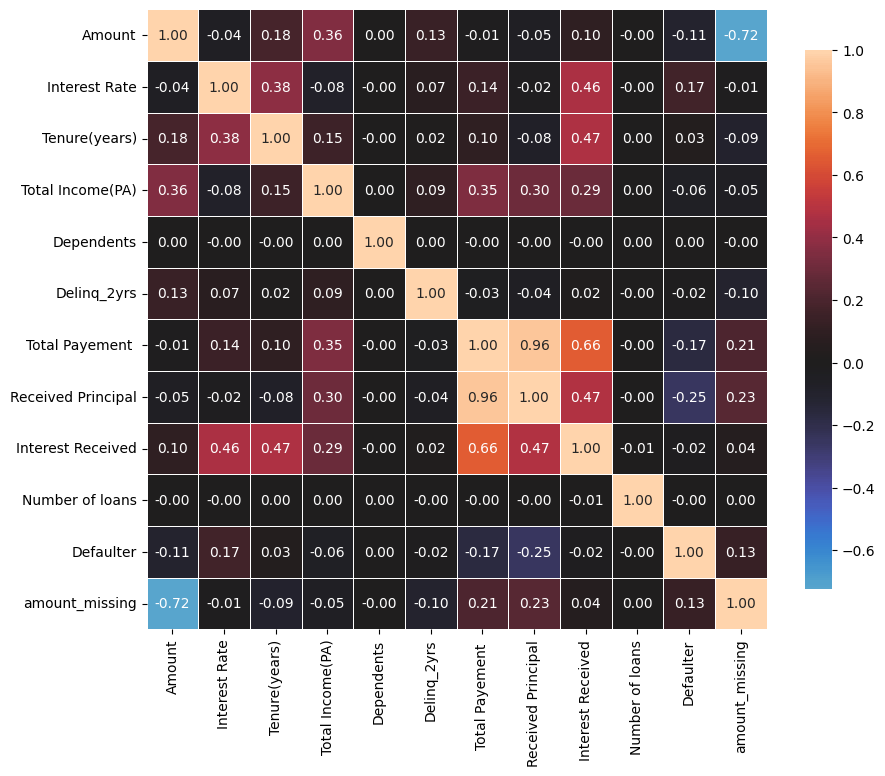

In [19]:
# Multicollinarity is the occurrence of high intercorrelations among two or more independent variables in a multiple regression mode

correlation_heatmap(df)

**Observation from the heatmap**

No two variables have high correlation with each other, so there is no issue of multicollinearity. It's safe to use all variables in machine learning model building.


**Spearman Correlation Coefficient**

Spearman works best if there are nonlinear relationships between different variables.

****

**We can confirm non-linear relationship b/w features by looking at pair-wise scatter plots below**

There are non-linear relationships b/w features, so our decision of going with spearman was CORRECT.

#### **Scatter Plots to visualize correlations between x variables**

The following code generates a scatter plot matrix, also known as a pair plot, of all numeric features in the input DataFrame using the seaborn library.

The diagonal of the plot matrix shows a histogram of each variable's distribution. This allows for visual inspection of the pairwise relationships between variables, which can be useful for identifying patterns, trends, correlations, or potential outliers in the data.

In [20]:
def plot_pairwise_scatter(df):
    # Get the list of numeric features
    features = df.select_dtypes(include='number').columns

    # Create the pairwise scatter plots using Seaborn
    sns.pairplot(df[features])

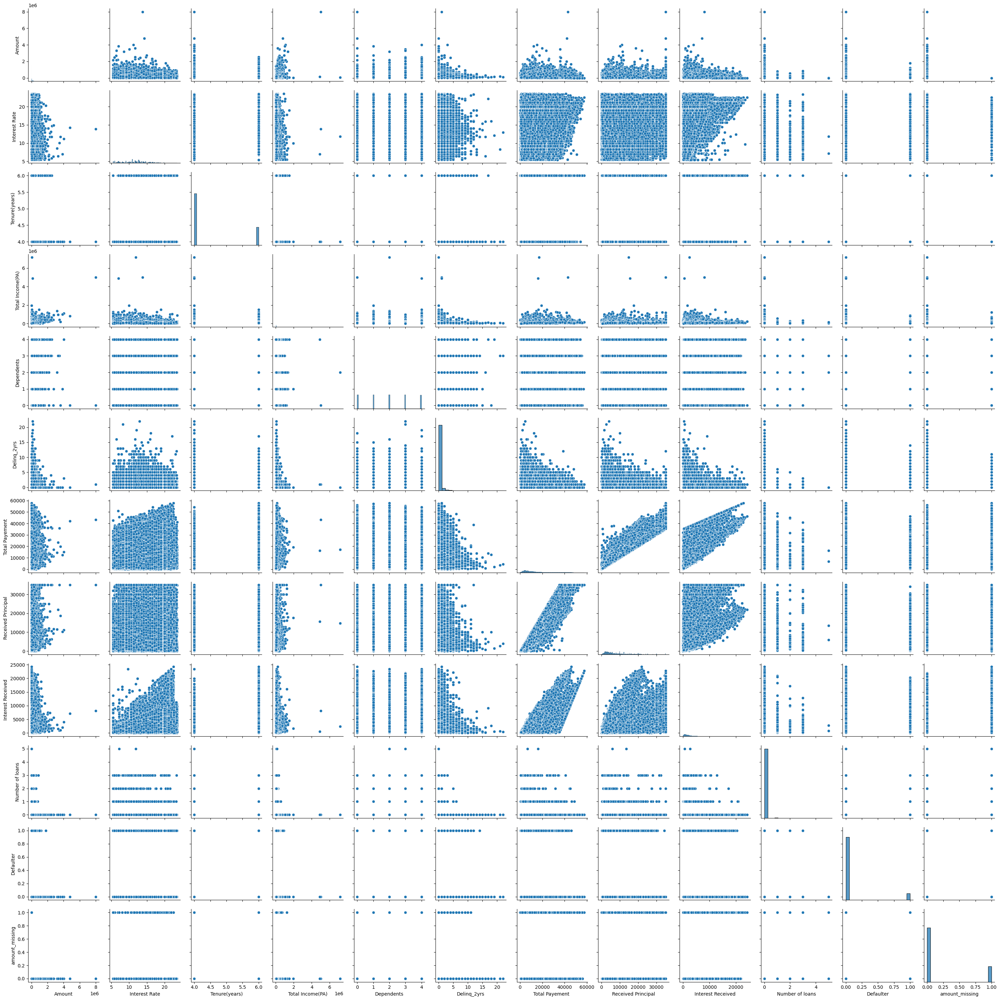

In [21]:
# Let's plot all interaction scatter plots using seaborn

# Call the function to plot pairwise scatter plots
plot_pairwise_scatter(df)



**Analysis**

****

- Scatterplots can help us confirm multicollinearity between two variables. We  can look at the scatterplot to check if there is any pattern or correlation between two variables.**

- Multicollinearity makes explainability less trustworthy as change in one variablte will not only impact the target variable but also impact other X variables. Means how much does a variable impact target variable would be hard



### **Skewness**

#### **Understand Skewness**

In [22]:
import plotly.express as px
def Feature_Distributions_Histogram(df):
    # Generate histograms for each column
    for c in df.columns:
        fig = px.histogram(df, x=c, hover_data=df.columns)
        fig.show()


In [23]:
# To identify anomalies in each column, it is essential to examine the distributions of the variables in the dataset.

# Call the function to plot histograms
Feature_Distributions_Histogram(df)

**Concept of skewness:**

Imagine a seesaw in a playground. If the seesaw is perfectly balanced, it means both ends are at the same height and there is no tilt. Similarly, a symmetric distribution has equal amounts of data on both sides of the central point, resulting in a balance.

However, if the seesaw is tilted to one side, it indicates an imbalance. Similarly, if a distribution is skewed, it means there is more data concentrated on one side compared to the other. This imbalance causes the distribution to have a "tail" that stretches towards the side with fewer data points.

Skewness helps us understand the direction and degree of this imbalance. If the tail stretches to the right side, we call it positive skewness, indicating a longer right tail. Conversely, if the tail stretches to the left side, we call it negative skewness, indicating a longer left tail.

**Positive skewness:**

Imagine a line plot or histogram representing the heights of students in a class. In a class with right skewness, most students will have heights clustered towards the shorter side, and there will be a few students with taller heights. The right tail of the distribution will be longer, indicating the presence of outliers or extreme values on the taller side.

**Negative Skewness:**
Consider a line plot or histogram representing the time spent studying for an exam. In a situation with left skewness, most students might have relatively high study times, and there will be a few students with very low study times. The left tail of the distribution will be longer, indicating the presence of outliers or extreme values on the lower side.

**Analysis after Distribution:**

1. Amount: The distribution of the 'Amount' variable is right-skewed, indicating that a majority of loan amounts are lower, while a few instances have higher values.

2. Employment Type: The distribution of the 'Employment Type' variable shows an imbalance, suggesting that certain employment types may be overrepresented in the dataset compared to others.

3. Work Experience: The 'Work Experience' variable also exhibits imbalanced data, implying that certain levels of work experience may be more prevalent than others.

4. Pincode: The 'Pincode' variable contains a large number of categories, which may pose challenges for analysis. Considering converting it into latitude and longitude coordinates could offer a more manageable representation.

5. Delinq_2years: The distribution of the 'Delinq_2years' variable is right-skewed, indicating that most individuals have a low number of delinquencies, while a few have a higher count.

6. Payment: The 'Payment' variable displays a right-skewed distribution, suggesting that the majority of payment amounts are lower, with a few instances of higher payments.
7. Received Principal: The distribution of the 'Received Principal' variable is right-skewed, indicating that most individuals have received a lower principal amount, while a few have received a higher amount.

8. Interest Received: The 'Interest Received' variable exhibits a right-skewed distribution, suggesting that the majority of individuals have received a lower interest amount, while a few have received a higher interest payment.

**Outcome**

The resulting histograms will show the distribution of values in each column and can help identify potential outliers or anomalies in the data. For example, if a column has a very skewed distribution or contains a large number of extreme values, this may indicate that the data is not representative or that there are errors or issues with the data collection process.

Note that generating histograms for a large number of columns can be computationally intensive and may take some time to run, especially for large datasets.

#### **Fixing Skewness in the Data**

**Skewness**

- Skewness is a statistical measure that describes the asymmetry or lack of symmetry in a distribution. It provides insights into the shape of the distribution and the relative positioning of the mean, median, and mode.
- A positive skewness value indicates a right-skewed distribution, where the tail is elongated towards the right. A negative skewness value indicates a left-skewed distribution, where the tail is elongated towards the left. A skewness value of 0 indicates a symmetric distribution.
- By quantifying skewness, we can gain a numerical understanding of the distribution's asymmetry and further analyze its implications in data analysis and modeling


**How to quantify skewness?**

* skewness = 3 * (mean - median) / standard deviation.

****
**Question to consider**

* Should we remove outliers/extreme values first and then fix skewness or the otherway around?
****
**Decision**
* To address the presence of outliers in skewed data, we'll first correct the skewness.
* One approach to mitigating the impact of outliers is by utilizing the z-score. The z-score measures how many standard deviations an individual data point is away from the mean. By setting a threshold, such as 3 standard deviations, data points that exceed this threshold can be considered as outliers and subsequently removed from the dataset.


**Let's print skewness in each feature and use log transformation to fix skewness.**

**Note**

It is important to note that there are numerous features in the dataset with a value of 0. To address this issue and normalize the data, we can apply a log transformation specifically to the non-zero values. By taking the logarithm of these values, we can achieve a more symmetric distribution and reduce the impact of extreme values. This transformation can be particularly useful when working with skewed data or variables that exhibit a wide range of values.

Let's only transform features if skewness is in the following range
* **Skewness < -3 OR Skewness > 3**


In [24]:
# Fix skewness in the datframe
def fix_skewness(df, features):
  features_log = features
  for f in features_log:
    sk= df[f].skew()
    print("Inital skewness in feature: ",f," is: ", sk)

    if sk>3 or sk< -3:

      Log_Fare = df[f].map(lambda i: np.log(i) if i > 0 else 0)
      df[f]=Log_Fare
      print("Final skewness in feature: ",f," is: ", Log_Fare.skew())
      fig = px.histogram(Log_Fare, x=f)
      fig.show()

  return df

In [25]:
# Add all the features to check and fix skewness in features_log array
features_log= ['Amount','Interest Rate','Tenure(years)','Dependents','Total Payement ','Received Principal','Interest Received']

df= fix_skewness(df, features_log)


Inital skewness in feature:  Amount  is:  4.263131668127463
Final skewness in feature:  Amount  is:  -1.150620021957597


Inital skewness in feature:  Interest Rate  is:  0.3570183681924867
Inital skewness in feature:  Tenure(years)  is:  1.1107257129630685
Inital skewness in feature:  Dependents  is:  0.0009324906324210842
Inital skewness in feature:  Total Payement   is:  1.56758246496732
Inital skewness in feature:  Received Principal  is:  1.5217975693302837
Inital skewness in feature:  Interest Received  is:  2.8360693754096626


### **One Hot Encoding of Categorical Features and Ordinal Encoding of Ordinal Features**




**Categorical and Ordinal Variables**

Categorical variables refer to variables that represent discrete categories or labels, such as gender (male/female), marital status (single/married/divorced), or product types (A/B/C). These variables do not have a specific numerical order or hierarchy.

On the other hand, ordinal variables also represent discrete categories, but they have an inherent order or ranking associated with them. Examples of ordinal variables include education level (elementary/middle/high school/college), employment status (unemployed/part-time/full-time), or customer satisfaction rating (low/medium/high).

#### **Categorical Hot-Encoding**

In [26]:
import pandas as pd

# Add all categorical features for categorical one-hot encoding in categorical_features array
data = df
categorical_features= ["Gender", "Married", "Home", "Social Profile", "Loan Category", "Employmet type","Is_verified", ]

# Perform one-hot encoding using pandas get_dummies() function
encoded_data = pd.get_dummies(data, columns=categorical_features)



#### **Ordinal Encoding**

In [27]:
from sklearn.preprocessing import OrdinalEncoder
import pandas as pd

def perform_ordinal_encoding(data, ordinal_features, custom_mapping):
    # Perform ordinal encoding using OrdinalEncoder with the custom mapping
    encoder = OrdinalEncoder(categories=custom_mapping)
    data[ordinal_features] = encoder.fit_transform(data[ordinal_features])

    # Return the encoded DataFrame
    return data

# Define the ordinal categorical features array
ordinal_features = ["Tier of Employment", "Work Experience"]

# Define the pandas DataFrame for encoding
data = encoded_data  # Assuming encoded_data is defined elsewhere

# Convert the "Work Experience" column to strings
data["Work Experience"] = data["Work Experience"].astype(str)

# Create a custom mapping of categories to numerical labels
tier_employment_order = list(encoded_data["Tier of Employment"].unique())
tier_employment_order.sort()

# Ensure all values in work_experience_order are strings
work_experience_order = ['0', '<1', '1-2', '2-3', '3-5', '5-10', '10+']

# Combine the custom mapping
custom_mapping = [tier_employment_order, work_experience_order]

# Debugging: Check unique values in the DataFrame
print("Unique values in 'Tier of Employment':", data["Tier of Employment"].unique())
print("Unique values in 'Work Experience':", data["Work Experience"].unique())

# Call the function to perform ordinal encoding
try:
    data = perform_ordinal_encoding(data, ordinal_features, custom_mapping)
except ValueError as e:
    print("ValueError:", e)

Unique values in 'Tier of Employment': ['B' 'D' 'Z' 'C' 'A' 'E' 'G' 'F']
Unique values in 'Work Experience': ['1-2' '10+' '5-10' '2-3' '3-5' '0' '<1']


In [28]:
data

,Amount,Interest Rate,Tenure(years),Tier of Employment,Work Experience,Total Income(PA),Dependents,Delinq_2yrs,Total Payement,Received Principal,...,Loan Category_Home,Loan Category_Medical,Loan Category_Other,Employmet type_Salaried,Employmet type_Self - Employeed,Employmet type_missing,Is_verified_Not Verified,Is_verified_Source Verified,Is_verified_Verified,Is_verified_missing
0,10.931033,11.84,6,1.0,2.0,125000.0,4,0,1824.150000,971.46,...,False,False,False,True,False,False,False,False,False,True
1,10.924336,16.94,4,3.0,6.0,61000.0,1,0,22912.532998,18000.00,...,False,False,False,False,True,False,False,True,False,False
2,9.416460,11.84,6,7.0,5.0,100000.0,3,0,7800.440000,4489.76,...,False,False,False,False,False,True,False,False,False,True
3,10.286162,14.71,4,7.0,3.0,30000.0,1,0,6672.050000,5212.29,...,False,False,False,False,False,True,False,False,False,True
4,10.317318,14.71,4,7.0,6.0,65000.0,3,0,11793.001345,10000.00,...,False,False,False,False,False,True,False,False,True,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
143722,12.569201,12.06,6,7.0,0.0,100000.0,2,1,12842.400000,7193.83,...,False,False,False,False,False,True,False,True,False,False
143723,10.811988,14.10,4,7.0,0.0,27000.0,3,0,839.200000,581.67,...,False,False,True,False,False,True,False,True,False,False
143724,9.520175,18.96,6,7.0,0.0,53000.0,2,0,6085.800000,2434.49,...,False,False,False,False,False,True,False,False,False,True
143725,12.138452,8.28,4,7.0,0.0,75400.0,0,0,4080.640000,3286.82,...,True,False,False,False,False,True,False,True,False,False


### **Fix data imbalance in the target variable**

**Oversampling**

 Increase the number of instances in the minority class (defaulters) by duplicating existing examples or generating synthetic examples to achieve a balanced dataset.

In [29]:
from imblearn.over_sampling import RandomOverSampler
def fix_imbalance_using_oversamping(dataframe, target_column):


  # Separate the features and the target variable
  X = dataframe.drop(target_column, axis=1)
  y = dataframe[target_column]

  # Apply random oversampling using RandomOverSampler
  oversampler = RandomOverSampler(random_state=42)
  X, y = oversampler.fit_resample(X, y)

  return X, y

In [30]:
# Specify the name of the target variable column
target_column="Defaulter"

X, y= fix_imbalance_using_oversamping(data, target_column)


**SMOTE**

SMOTE (Synthetic Minority Over-sampling Technique) is a popular technique used in machine learning and data mining to address the issue of imbalanced datasets. Imbalanced datasets are characterized by a significant difference in the number of instances between the classes, where one class (the minority class) has a much smaller representation than the other class(es) (the majority class(es)).

SMOTE works by generating synthetic samples for the minority class to balance the class distribution. It does this by creating synthetic examples along the line segments connecting minority class instances. Here's a high-level overview of how SMOTE works:

For each instance in the minority class, SMOTE selects one or more of its k nearest neighbors from the same class. The value of k is a user-defined parameter.
Synthetic samples are created by randomly selecting one or more of the nearest neighbors and using them to form new samples. This is done by interpolating the feature values between the selected instance and its neighbor(s). For example, if there are two nearest neighbors, SMOTE can create a synthetic sample by taking a weighted average of the feature values of the two neighbors.
The synthetic samples are added to the dataset, effectively increasing the representation of the minority class. This process is repeated until the desired balance between the classes is achieved.
SMOTE helps to overcome the problem of imbalanced datasets by increasing the diversity of the minority class and reducing the bias towards the majority class during training. This can improve the performance of machine learning models by ensuring that the model is exposed to a more balanced representation of the data.


In [31]:
import pandas as pd
from imblearn.over_sampling import SMOTE

# Assuming you have your pandas DataFrame df with features and target variable

# Separate the features (X) and target variable (y) from the DataFrame
X = data.drop('Defaulter', axis=1)
y = data['Defaulter']

# Initialize the SMOTE oversampling algorithm
smote = SMOTE(random_state=42)

# Convert X and y to NumPy arrays
X_array = X.values
y_array = y.values

# Perform oversampling on the data
X_resampled, y_resampled = smote.fit_resample(X_array, y_array)

# Convert the resampled arrays back to a pandas DataFrame
X_resampled_df = pd.DataFrame(X_resampled, columns=X.columns)
y_resampled_df = pd.DataFrame(y_resampled, columns=['target'])

# Print the class distribution before and after oversampling
print("Class distribution before oversampling:")
print(y.value_counts())

print("Class distribution after oversampling:")
print(y_resampled_df['target'].value_counts())

X= X_resampled_df
y= y_resampled_df


Class distribution before oversampling:
Defaulter
0    130254
1     13469
Name: count, dtype: int64
Class distribution after oversampling:
target
1    130254
0    130254
Name: count, dtype: int64


## **Split Data in training, validation, and testing datasets**

In [32]:
from sklearn.model_selection import train_test_split

#The test_size parameter is set to 0.2, indicating that 20% of the data will be allocated to the testing set, while the remaining 80% will be used for training.
#The random_state parameter is set to 42 to ensure reproducibility of the split, meaning that the same random split will be obtained each time the code is executed.
train_x, test_x, train_y, test_y = train_test_split(X, y, test_size=0.2, random_state=42)

# val_x, test_x, val_y, test_y = train_test_split(test_x, test_xy, test_size=0.5, random_state=42)


## **Model Training: Xgboost**

In [33]:
! pip install neptune neptune_xgboost

In [34]:
import numpy as np
import xgboost as xgb
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV
import time
from hyperopt import fmin, tpe, hp, STATUS_OK
from hyperopt.pyll import scope
import neptune
from neptune.integrations.xgboost import NeptuneCallback


import pickle
from sklearn.metrics import classification_report, confusion_matrix

### **Configure Neptune**

Format:

# Create a Neptune run object
run = neptune.init_run(
    project="your-workspace-name/your-project-name",  
    api_token="YourNeptuneApiToken",  
    tags=["quickstart", "script"],  # optional
)

In [35]:
# Configure Neptune
run = neptune.init_run(
    project="Abdelrhman/Abdelrhman",
    api_token="eyJhcGlfYWRkcmVzcyI6Imh0dHBzOi8vYXBwLm5lcHR1bmUuYWkiLCJhcGlfdXJsIjoiaHR0cHM6Ly9hcHAubmVwdHVuZS5haSIsImFwaV9rZXkiOiI1MDExYjIyOC1iZjU0LTQ4ZjUtOTIzNy0zZmE4NzFhYzk5ZmEifQ==",
)
# Creating a NeptuneCallback object to integrate Neptune with XGBoost.
neptune_callback = NeptuneCallback(run=run, log_tree=[0, 1, 2, 3])


[neptune] [info   ] Neptune initialized. Open in the app: https://app.neptune.ai/Abdelrhman/Abdelrhman/e/AB-3


### **Model training with hyperopt**

**XGBoost hyperparameters**
***
- **Boosting hyperparameters:** Control the gradient descent process in boosting.

- **Tree hyperparameters:** Influence the construction of decision trees.

- **Stochastic hyperparameters:** Determine the subsampling of training data during model building.

- **Regularization hyperparameters:** Regulate model complexity to prevent overfitting.
***

In [36]:
#Defining a function named 'train_model' that takes 'params' as input.
def train_model_xgboost(params, neptune_callback, train_x, train_y, test_x, test_y):
    start_time = time.time()

    model = xgb.XGBClassifier(params=params, num_boost_round=5000, verbose_eval=False, callbacks=[neptune_callback])

    run_time = time.time() - start_time

    model.fit(train_x, train_y)

    predictions_test = model.predict(test_x)
    mae = mean_absolute_error(test_y, predictions_test)

    return {'status': STATUS_OK, 'loss': mae}



# This function will perfrom grid search on randon forest model and return the best params of the model

def random_forest_classifier_grid_search(param_grid, x_train, y_train):


    # Create a random forest classifier
    rf = RandomForestClassifier()

    # Perform grid search with cross-validation
    grid_search = GridSearchCV(rf, param_grid, cv=3, scoring='accuracy')
    grid_search.fit(x_train, y_train)

    # Print the best parameters found
    return grid_search.best_params_

In [37]:
# Define search space for hyperparameter tuning of XGBoost model.
search_space = {
    'learning_rate': hp.loguniform('learning_rate', -7, 0),
    'max_depth': scope.int(hp.uniform('max_depth', 1, 100)),
    'min_child_weight': hp.loguniform('min_child_weight', -2, 3),
    'subsample': hp.uniform('subsample', 0.5, 1),
    'colsample_bytree': hp.uniform('colsample_bytree', 0.5, 1),
    'gamma': hp.loguniform('gamma', -10, 10),
    'alpha': hp.loguniform('alpha', -10, 10),
    'lambda': hp.loguniform('lambda', -10, 10),
    'objective': 'binary:logistic',
    'eval_metric': 'error',
    'seed': 123,
}
train_x=train_x
train_y=train_y
test_x=test_x
test_y=test_y


# Finding the best hyperparameters using Hyperopt's fmin function.
best_params = fmin(
    fn=lambda params: train_model_xgboost(params, neptune_callback, train_x, train_y, test_x, test_y),
    space=search_space,
    algo=tpe.suggest,
    max_evals=15,
    rstate=np.random.default_rng(123)
)
run.stop()

# Let's print the params
print(best_params)


100%|██████████| 15/15 [04:55<00:00, 19.70s/trial, best loss: 0.01591109746266938]
[neptune] [info   ] Shutting down background jobs, please wait a moment...
[neptune] [info   ] Done!
[neptune] [info   ] Waiting for the remaining 6 operations to synchronize with Neptune. Do not kill this process.
[neptune] [info   ] All 6 operations synced, thanks for waiting!
[neptune] [info   ] Explore the metadata in the Neptune app: https://app.neptune.ai/Abdelrhman/Abdelrhman/e/AB-3/metadata
{'alpha': 10097.8429974375, 'colsample_bytree': 0.9941458252246209, 'gamma': 4995.254471659089, 'lambda': 6.390134508060656e-05, 'learning_rate': 0.09100767117912448, 'max_depth': 29.65059937692005, 'min_child_weight': 0.1765314436877681, 'subsample': 0.6246406667012787}


### **Best fit xgboost model**


In [38]:
# Access the best hyperparameters
best_hyperparams = {k: best_params[k] for k in best_params}

# Train the final XGBoost model with the best hyperparameters
final_model = xgb.XGBClassifier(
    max_depth=int(best_hyperparams['max_depth']),
    learning_rate=best_hyperparams['learning_rate'],
    gamma=best_hyperparams['gamma'],
    subsample=best_hyperparams['subsample'],
    colsample_bytree=best_hyperparams['colsample_bytree'],
    random_state=42,
    tree_method='hist',enable_categorical= True,  # Use GPU for faster training (if available)
)

final_model.fit(train_x, train_y)  # Train the final model on the entire dataset

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9941458252246209, device=None,
              early_stopping_rounds=None, enable_categorical=True,
              eval_metric=None, feature_types=None, gamma=4995.254471659089,
              grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.09100767117912448,
              max_bin=None, max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=29, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=None,
              num_parallel_tree=None, random_state=42, ...)

### **Model validation**

In [39]:
from sklearn.metrics import classification_report, confusion_matrix

# Make predictions on the test data
y_pred = final_model.predict(test_x)

# Print classification metrics
print("Classification Report:")
print(classification_report(test_y, y_pred))

print("Confusion Matrix:")
print(confusion_matrix(test_y, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.84      0.86      0.85     25882
           1       0.86      0.84      0.85     26220

    accuracy                           0.85     52102
   macro avg       0.85      0.85      0.85     52102
weighted avg       0.85      0.85      0.85     52102

Confusion Matrix:
[[22196  3686]
 [ 4212 22008]]


### **Save best fit model**

In [40]:
pickle.dump(final_model, open('xgboost_model.pkl', 'wb'))

In [41]:
!pip install shap
!pip install deepchecks alibi alibi[tensorflow]

In [42]:
from sklearn.metrics import roc_auc_score
import shap

**As Per our use Case the confusion matrix is:**

|  | Actual Positive(Default) | Actual Negative(Non-Default) |
| --- | --- | --- |
| Predicted Positive (Default) | 22196 | 3686 |
| Predicted Negative (Non-Default) | 4212 | 22008 |

- **Accuracy**: Accuracy is a performance metric that measures the overall correctness of the model's predictions. It is calculated by dividing the sum of true positives and true negatives by the total number of instances. In the loan default context, accuracy represents the percentage of correctly classified loans, both defaults and non-defaults.

  **Accuracy = (TP + TN) / (TP + TN + FP + FN)**

- **Precision:** Precision is a metric that quantifies the model's ability to correctly identify positive instances out of all instances predicted as positive. It focuses on minimizing false positives (FP). In the loan default context, precision represents the percentage of loans predicted as defaults that actually defaulted.

  **Precision = TP / (TP + FP)**

A higher precision indicates a lower rate of false positives, which means that the model is more accurate in predicting loan defaults.

- **Recall (Sensitivity or True Positive Rate):** Recall measures the model's ability to identify positive instances out of all actual positive instances correctly. It focuses on minimizing false negatives (FN). In the loan default context, recall represents the percentage of defaulted loans that the model correctly identified.

  **Recall = TP / (TP + FN)**

A higher recall indicates a lower rate of false negatives, indicating that the model is more effective at capturing actual loan defaults.

- **F1 Score:** The F1 score is a metric that combines both precision and recall to provide a balanced evaluation of the model's performance in predicting loan defaults. It is calculated as the harmonic mean of precision and recall, taking into account both false positives and false negatives.
    
In the loan default use case, the F1 score is particularly valuable when there is an imbalance between the two classes (defaults and non-defaults). By considering both precision and recall, the F1 score offers a comprehensive assessment of the model's ability to predict both default and non-default loans accurately.
    

  **F1 Score = 2 * (Precision * Recall) / (Precision + Recall)**

|  | Actual Positive (Default) | Actual Negative (Non-Default) |
| --- | --- | --- |
| Predicted Positive (Default) | TP | FP |
| Predicted Negative (Non-Default) | FN | TN |



|  | Actual Positive(Default) | Actual Negative(Non-Default) |
| --- | --- | --- |
| Predicted Positive (Default) | 22196 | 3686 |
| Predicted Negative (Non-Default) | 4212 | 22008 |

**False Positives (FP):** False positives occur when the model predicts a loan as default, but it actually is a non-default. In the given confusion matrix, the FP value is 3686. False positives can have the following impacts:

- If the model generates a high number of false positives due to biases, it may incorrectly classify deserving borrowers as high-risk or default-prone. Biases in the data or model can disproportionately affect certain groups, leading to the denial of loans to individuals who are actually creditworthy. This not only hampers opportunities for those individuals but also results in missed business opportunities for the lending institution.
- False positives can also result in customer dissatisfaction and harm the reputation of the lending institution. Applicants who are wrongly classified as default risks may feel unfairly treated, leading to loss of trust and potential business for the institution.
- Processing loan applications that are eventually rejected due to false positives can impose additional operational costs on the lending institution, impacting efficiency and profitability.

**False Negatives (FN):** False negatives occur when the model predicts a loan as non-default, but it actually is a default. In the given confusion matrix, the FN value is 4212. False negatives can have the following impacts:

- If the model generates a high number of false negatives, it may grant loans to borrowers who are likely to default. This can result in increased loan defaults and financial losses for the lending institution.
- Granting loans to borrowers who are likely to default can raise concerns from regulatory bodies, potentially leading to penalties, legal issues, or damage to the reputation of the lending institution.

**To illustrate the impact, let's consider some hypothetical values for the cost of loss:**

- Cost of FP: 10,000 (Let's assume that the average amount of loan given to the customer is more than 10,000 and a lending institution will lose 10,000 on average if someone doesn’t default. This is the cost associated with incorrectly classifying a loan as default)
- Cost of FN: 50,000 (Let's assume that the average amount of loan given to the customer is more than 50,000, and a lending institution will lose 50,000 on average if someone default. This is the cost associated with incorrectly classifying a loan as non-default)

Using these values, we can calculate the total cost of errors based on the confusion matrix:

Total Cost = (FP * Cost of FP) + (FN * Cost of FN)

Total Cost = (3686 * 10000) + (4212 * 50,000)

Total Cost = 247.46 million

The total cost of errors depends on the specific cost values assigned to FP and FN and can help assess the financial impact of misclassifications in the loan default use case. By adjusting the cost values, organizations can prioritize minimizing the type of error that incurs higher financial losses and optimize their model accordingly.

1. The cost of giving a loan to potential defaulters is 50,000 * 4212 = 210.6 million. This cost represents the potential loss incurred when loans are granted to individuals who are likely to default.
2. The cost of not giving the loan to non-defaulters is 10,000 * 3686 = 36.86 million. This cost represents missed business opportunities and potential revenue when loans are denied to individuals who would not default.
3. Considering the higher cost associated with giving loans to potential defaulters, it becomes a priority for data scientists to tune the model to reduce false negatives. This implies that the focus should be on improving both precision and recall for non-defaulters.
4. We can tell the data scientists that we have to reduce FN to increase the precision and recall for non-defaulters.
5. Data Scientists may explore various approaches, such as fine-tuning the model, optimizing feature selection, or incorporating additional relevant data sources.
6. Ultimately, the goal is to strike a balance between minimizing the risk of default by accurately identifying potential defaulters while avoiding unnecessary loan denials to creditworthy individuals. This strategy can help mitigate losses and ensure responsible lending practices, benefiting both the lending institution and its customers.

###**DeepChecks On False Positives**

Let’s use DeepChecks to understand false positives in detail and the steps get false positives from the dataset:

- Filter out rows with false positive outcome.
- Utilize the DeepChecks library to analyze and Identify weak segments within the false positive segment.
- Utilize the identified weak segments to validate or invalidate any assumptions about biases in the model and assess whether the model exhibits biases against specific groups or segments within the false positive segment. Explore the data and examine potential factors, such as gender or age, to determine if biases exist and take appropriate actions to address them.


**Conclusion:**

Based on the DeepChecks analysis of false positives, we can draw the following conclusions:

1. The examination of weak segments within the false positives indicates that the misclassifications are not influenced by factors such as age and gender. This suggests that the model is not biased based on these attributes.
2.  The weak segments contributing to false positives are related to the features "Received Principal vs Amount," "Received Principal vs Work Experience," and "Received Principal." These features are responsible for the model's misclassifications but do not involve any attributes that could justify the presence of bias.

In [43]:
def filter_test_data_based_actual_prediction(test_x, test_y,y_pred, actual=1, prediction=0  ):

  ## Filter False negatives

  # Assuming you have a DataFrame called df and a numpy array called y_pred

  # Convert the numpy array to a pandas Series
  Predictions = pd.Series(y_pred, name='Predictions')

  # Merge the Series with the DataFrame
  merged_df = pd.concat([test_y, Predictions], axis=1)


  filtered_df = merged_df[(merged_df['target'] == actual) & (merged_df['Predictions'] == prediction)]


  # Assuming you have the 'test_x' DataFrame and 'filtered_df' DataFrame already defined

  # Get the index of the filtered_df
  filtered_index = filtered_df.index

  # Filter the test_x DataFrame based on the same index
  filtered_test_x = test_x.loc[filtered_index]

  # Concatenate test_x and filtered_df along the columns axis
  concatenated_df = pd.concat([filtered_test_x, filtered_df], axis=1)

  # Assuming you have a DataFrame called 'data' and want to extract the column 'column_name'

  # Split the data into features (X) and labels (y)
  test_x_FN = concatenated_df.drop(['Predictions', 'target'], axis=1)  # Features (all columns except 'column_name')
  test_y_FN = concatenated_df['target']  # Label column

  return test_x_FN, test_y_FN

test_x_FP, test_y_FP= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=0, prediction=1 )


In [44]:
#The check is designed to help you easily identify the model’s weakest segments in the data provided.
#In addition, it enables to provide a sublist of the Dataset’s features, thus limiting the check to search in interesting subspaces.
from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import WeakSegmentsPerformance


# Create a DeepChecks Dataset from the test data
dataset = Dataset(test_x_FP, test_y_FP)
WeakSegmentsPerformance().run(dataset, final_model)

deepchecks - WARNING - It is recommended to initialize Dataset with categorical features by doing "Dataset(df, cat_features=categorical_list)". No categorical features were passed, therefore heuristically inferring categorical features in the data. 35 categorical features were inferred.: Tenure(years), Tier of Employment, Work Experience, Dependents, Delinq_2yrs, Number of loans, amount_missing... For full list use dataset.cat_features


<!--
 ~ ----------------------------------------------------------------------------
 ~ Copyright (C) 2021-2023 Deepchecks (https://www.deepchecks.com)
 ~
 ~ This file is part of Deepchecks.
 ~ Deepchecks is distributed under the terms of the GNU Affero General
 ~ Public License (version 3 or later).
 ~ You should have received a copy of the GNU Affero General Public License
 ~ along with Deepchecks. If not, see .
 ~ ----------------------------------------------------------------------------
 ~
-->
<!DOCTYPE html>
 
 
 
 Weak Segments Performance

In [45]:
# Priniting weak segments in dataframe format

result= WeakSegmentsPerformance().run(dataset, final_model)
result.value['weak_segments_list'].head(3)

,Accuracy Score,Feature1,Feature1 Range,Feature2,Feature2 Range,% of Data,Samples in Segment
0,0.203704,Received Principal,"(-inf, 4818.68994140625)",,None,11.21,"[23044, 37460, 4665, 22698, 45565, 26332, 4992..."
15,0.669206,Amount,"(-inf, 8.965706825256348)",,None,36.32,"[40125, 40272, 43267, 40134, 49277, 39057, 379..."


### **DeepChecks on False Negatives**

Let’s use DeepChecks to understand false negatives in detail.

**Conclusion:**

Based on the DeepChecks analysis of false negatives, we can draw the following conclusions:

1. The weak segments identified as "Received Principal vs Amount," "Received Principal vs Work Experience," and "Received Principal" are crucial factors related to the use case of loan defaults. We can focus on building a new model specifically designed to cater to these segments.
2. We can further investigate the relationships between the received principal, amount, work experience, and other relevant features. This exploration may reveal opportunities for creating new features or transforming existing ones.

In [46]:
test_x_FN, test_y_FN= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=1, prediction=0 )

In [47]:
#The check is designed to help you easily identify the model’s weakest segments in the data provided.
#In addition, it enables to provide a sublist of the Dataset’s features, thus limiting the check to search in interesting subspaces.
from deepchecks.tabular import Dataset
from deepchecks.tabular.checks import WeakSegmentsPerformance


# Create a DeepChecks Dataset from the test data
dataset = Dataset(test_x_FN, test_y_FN)
WeakSegmentsPerformance().run(dataset, final_model)


deepchecks - WARNING - It is recommended to initialize Dataset with categorical features by doing "Dataset(df, cat_features=categorical_list)". No categorical features were passed, therefore heuristically inferring categorical features in the data. 35 categorical features were inferred.: Tenure(years), Tier of Employment, Work Experience, Dependents, Delinq_2yrs, Number of loans, amount_missing... For full list use dataset.cat_features


<!--
 ~ ----------------------------------------------------------------------------
 ~ Copyright (C) 2021-2023 Deepchecks (https://www.deepchecks.com)
 ~
 ~ This file is part of Deepchecks.
 ~ Deepchecks is distributed under the terms of the GNU Affero General
 ~ Public License (version 3 or later).
 ~ You should have received a copy of the GNU Affero General Public License
 ~ along with Deepchecks. If not, see .
 ~ ----------------------------------------------------------------------------
 ~
-->
<!DOCTYPE html>
 
 
 
 Weak Segments Performance

## **Global-level explaination using SHAP**

To get an overview of which features are most important for a model we can plot the SHAP values of every feature for every sample. The plot below sorts features by the sum of SHAP value magnitudes over all samples, and uses SHAP values to show the distribution of the impacts each feature has on the model output. The color represents the feature value (red high, blue low). This reveals for example that a high Principal Received lowers the predicted default probability.

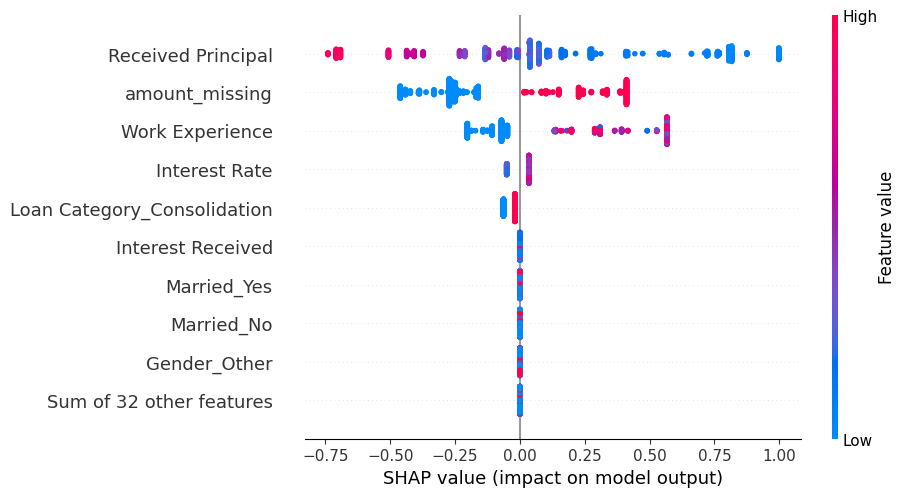

In [48]:
# Create a SHAP TreeExplainer
explainer = shap.TreeExplainer(final_model)

# Calculate SHAP values for the testing data

dmatrix_test = xgb.DMatrix(test_x, enable_categorical=True) # Optional. Use if you have categorical data in processed data

shap_values = explainer(test_x_FN)

# summarize the effects of all the features
shap.plots.beeswarm(shap_values)
# shap.plots.bar(shap_values)

**Key Insights for Data Scientists, Business Stakeholders and Regulators**

**1. Data Scientists:**
For data scientists, understanding the importance of features is crucial for model development, feature selection, and model interpretation. A feature importance graph provides insights into the relative importance of different input variables or features in predicting the target variable (creditworthiness in this case).

Feature importance can be determined using various techniques such as permutation importance, feature importance from tree-based models (e.g., Random Forest or Gradient Boosting), or coefficients from linear models (e.g., logistic regression). The importance is typically represented as a graph, where the features are ranked based on their relevance.

By analyzing the feature importance graph, data scientists can gain several benefits:

- **Model Development:** Feature importance helps identify the most influential features, allowing data scientists to focus on the critical aspects of the credit lending decision process. This knowledge can guide feature engineering efforts and enhance the model's predictive performance.

- **Feature Selection:** Understanding feature importance aids in selecting the most relevant and informative features. By eliminating less important or redundant features, data scientists can simplify the model, reduce computational complexity, and potentially improve interpretability.

- **Model Interpretation:** Feature importance provides insights into the underlying factors driving the model's predictions. Data scientists can explain to stakeholders the rationale behind the model's decision-making process by highlighting the key features that contribute significantly to the creditworthiness assessment.

**2. Business Stakeholders:**
Business stakeholders, such as credit risk managers or product managers, are interested in understanding the factors that influence credit lending decisions. A feature importance graph helps them grasp the key drivers of creditworthiness assessments made by the model.
By reviewing the feature importance graph, business stakeholders can:

- **Gain Insights:** Understanding which features have the most significant impact on creditworthiness allows stakeholders to gain insights into the decision-making process. They can identify the critical factors contributing to positive or negative credit assessments, enabling them to align their business strategies accordingly.
- **Risk Management:** Feature importance helps stakeholders identify and monitor high-risk features that may have a strong impact on default rates or credit losses. This information allows them to develop risk mitigation strategies, adjust lending criteria, or implement targeted interventions to minimize potential risks.

**3. Regulators:**
Regulators are concerned with ensuring fairness and transparency in credit lending practices. When explaining the feature importance graph to regulators, it's important to highlight that the model's decision-making process is not based on discriminatory or biased features.
To address regulators' concerns, you can:

- **Highlight Non-Discriminatory Features:** By presenting the feature importance graph, you can emphasize that the model assigns importance based on the predictive power of features, rather than sensitive attributes such as race, gender, or ethnicity. This demonstrates that the model's decision-making is aligned with fair lending practices.
- **Transparency:** The feature importance graph provides regulators with visibility into the factors influencing the credit lending decisions. This transparency helps regulators assess the model's fairness, identify potential biases, and ensure compliance with regulatory requirements.

We can also use SHAP to understand how the machine learning model behaves in different scenarios. Previously we disucsssed how important it is for us to understand False Positives and False Negatives. By running SHAP on False Positives and Negatives datasets, we can see most important features and how they impact the output of the model.

### SHAP on False Positives

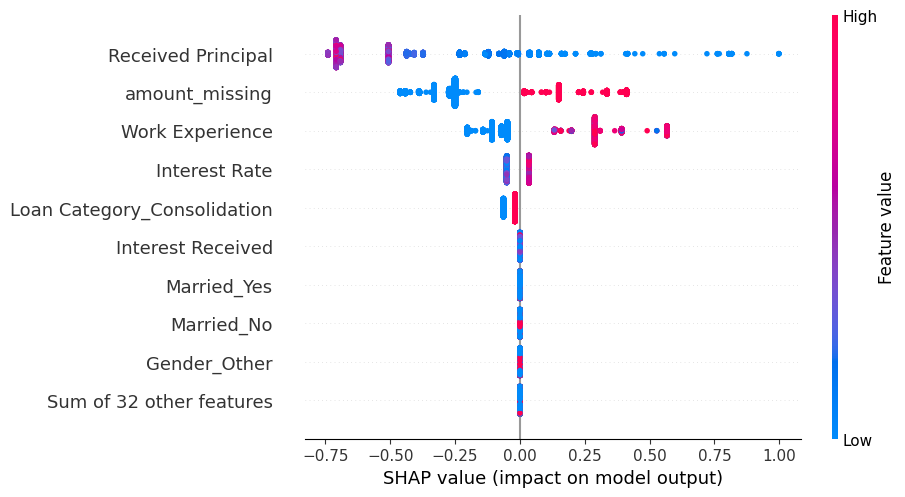

In [49]:
# Create a SHAP TreeExplainer
explainer = shap.TreeExplainer(final_model)

# Calculate SHAP values for the testing data

dmatrix_test = xgb.DMatrix(test_x_FP, enable_categorical=True) # Optional. Use if you have categorical data in processed data

shap_values = explainer(test_x_FP)

# summarize the effects of all the features
shap.plots.beeswarm(shap_values)
# shap.plots.bar(shap_values)

To understand how a single feature effects the output of the model we can plot the SHAP value of that feature vs. the value of the feature for all the examples in a dataset. Check out the feature dependence plot below.

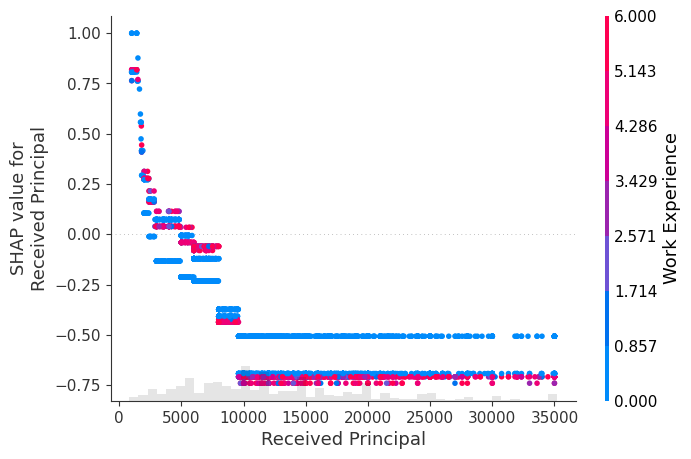

In [50]:
# create a dependence scatter plot to show the effect of a single feature across the whole dataset
shap.plots.scatter(shap_values[:,"Received Principal"], color=shap_values)

We can see above that SHAP value (impact on the model output) decreases with the increase in the Received Principal amount.

Just to reiterate the definition of shap values, positive shap value will increase the prediction of the model and negative shap value will decrease the prediction of the model.

### SHAP on False Negatives

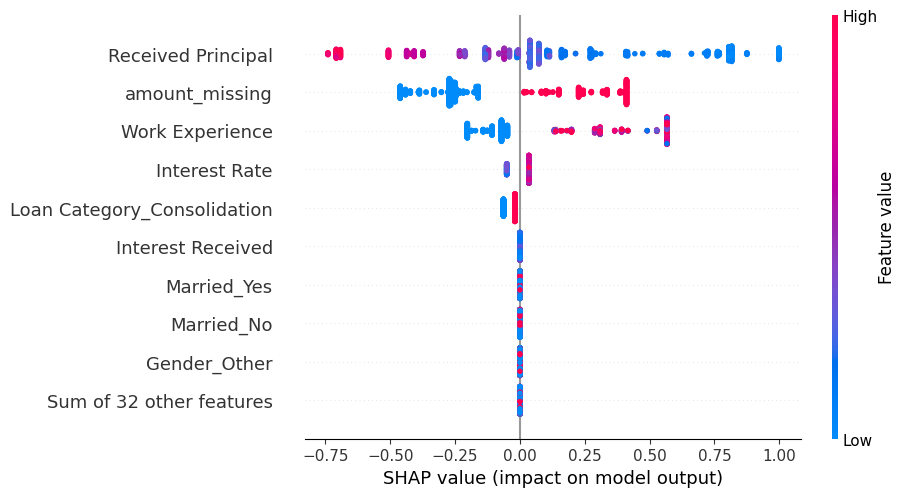

In [51]:
# Create a SHAP TreeExplainer
explainer = shap.TreeExplainer(final_model)

# Calculate SHAP values for the testing data

dmatrix_test = xgb.DMatrix(test_x_FN, enable_categorical=True) # Optional. Use if you have categorical data in processed data

shap_values = explainer(test_x_FN)

# summarize the effects of all the features
shap.plots.beeswarm(shap_values)

We can see that work experience is more important than interest rate in False Negatives. Does this ranking of features align with understanding of the credit lending that business stakeholders and regulators have in mind? We can present them to find out.

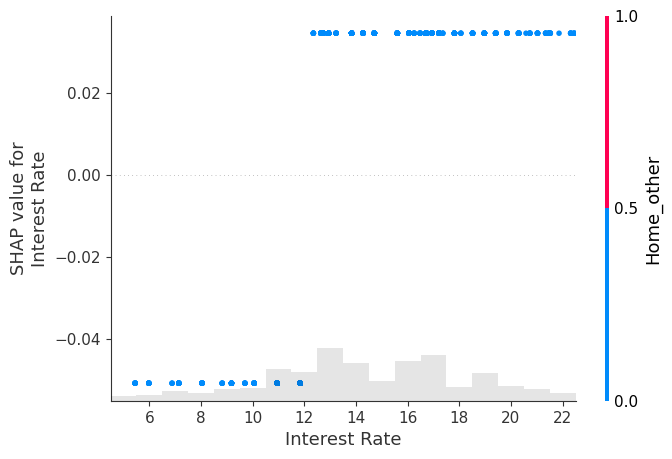

In [52]:
shap.plots.scatter(shap_values[:,"Interest Rate"], color=shap_values)


## **Explain each prediction using SHAP**

Local-level explanations provide data scientists with the ability to explain how different features contribute together to arrive at a specific prediction for an individual instance. These explanations can be valuable when communicating with business stakeholders and regulators. Here are some examples of how data scientists can use local-level explanations to explain the model:

**1. Explaining Creditworthiness Assessment to Business Stakeholders:**
Data scientists can use local-level explanations to demonstrate how the model evaluates the creditworthiness of specific individuals. For example:
- **Case 1:** Data scientists can select a sample customer and present a local-level explanation that showcases the most influential features contributing to the creditworthiness assessment. They can explain how each feature's value affects the model's prediction, allowing stakeholders to understand the factors driving the specific decision for that customer.
- **Case 2:** Data scientists can compare two customers with different creditworthiness outcomes but similar values for most features. By highlighting the specific feature(s) that differ between the two customers, they can explain how that feature influenced the divergent predictions. This helps stakeholders understand the relative importance of various factors in the creditworthiness assessment.

By providing these personalized explanations at the individual level, data scientists can help business stakeholders understand how the model arrives at its decisions, gain insights into the factors influencing creditworthiness assessments, and make informed business decisions based on the model's findings.

**2. Demonstrating Fairness and Non-Discrimination to Regulators:**
Regulators are particularly concerned with ensuring that credit lending models are fair, transparent, and non-discriminatory. Local-level explanations can assist data scientists in addressing these concerns:
- **Case 1:** Data scientists can select customers from different demographic groups (e.g., based on race, gender) and present local-level explanations to regulators. By highlighting the features that contribute to the predictions for each customer, data scientists can demonstrate that the model's decisions are not based on discriminatory attributes. This helps regulators gain confidence in the fairness of the model.
- **Case 2:** Data scientists can provide local-level explanations for customers who have experienced adverse outcomes, such as being denied credit or receiving unfavorable terms. By analyzing the influential features for these customers, data scientists can identify any potential biases or disparities in the model's decision-making. They can then explain to regulators how the model treats different customers fairly and ensure compliance with regulatory requirements.

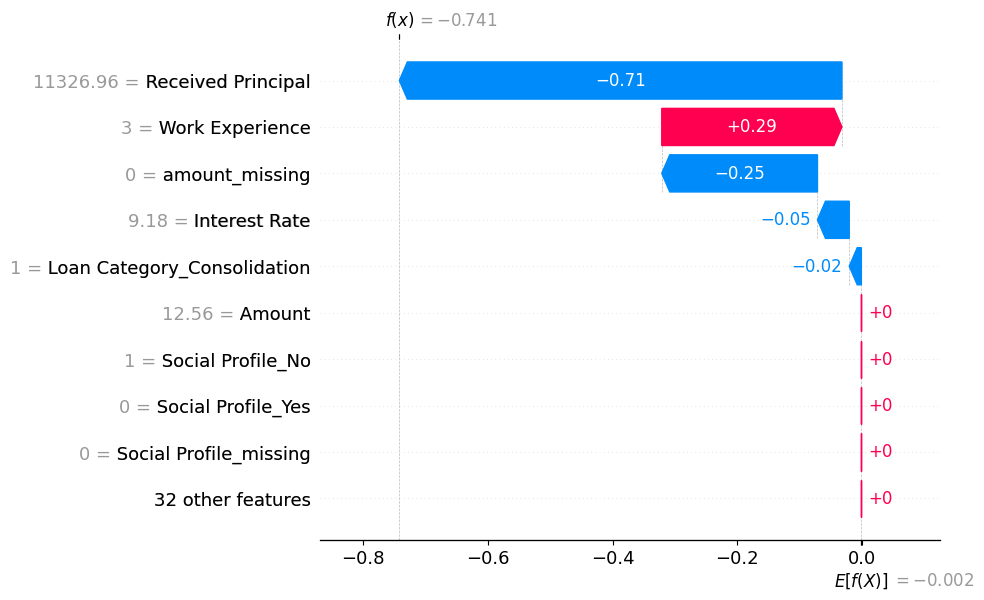

In [53]:
# visualize the first prediction's explanation
shap.plots.waterfall(shap_values[1])

f(x) is the output of the model. Output of the model is close to 0 and 0 stands for 'non default'. We can see above how individual feature and it's value impacted the output of the model.

##**Explain each prediction using Anchors**

Let's first learn about Anchors

- Anchors are like rules that explain how a model makes predictions. They tell us which features of an instance should be kept the same to get a specific prediction.
- An anchor can have a single rule, which is called a predicate. It can also have multiple rules, which are connected by "AND".
- Anchors are in the form of ‘IF-THEN’. Multiple rules will be separated by ‘AND’. In our example, the anchor consists of two rules: **“**If the **person is female** AND **belongs to the first class**, THEN **predict that they survived.”**
- Let’s understand the concept of coverage. By keeping the anchor features fixed and varying the other features, we can check different instances. In the Titanic example, about 15% of instances have the same anchor features (female and first class) but different other features.
- Precision means, how much our model predicted accurately out of the coverage instances. In the example, Out of those 15% instances, our model accurately predicted the survival outcome ("Survived = True") with a precision of 97%.

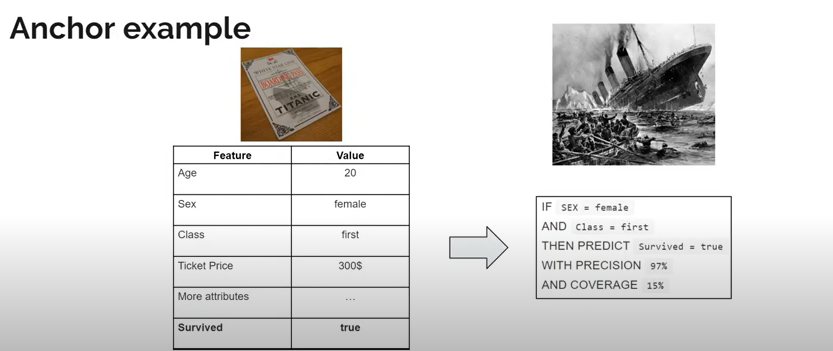

Here is the code to find an Anchor

In [54]:
from alibi.explainers import AnchorTabular


"""Initialize and train the anchor model"""
predict_fn = lambda x: final_model.predict_proba(x)
explainer = AnchorTabular(predict_fn, feature_names=train_x.columns)
# Fit the explainer with reference data
explainer.fit(train_x.values)

"""Find Anchor of customer at index 0"""
idx = 0 # record we would like to explain using anchors
class_names = ["No Default","Default"]

print('Prediction: ', class_names[explainer.predictor(train_x[idx:idx+1].values)[0]])

explanation = explainer.explain(train_x[idx:idx+1].values, threshold=0.95)
print('Anchor: %s' % (' AND '.join(explanation.anchor)))
print('Precision: %.2f' % explanation.precision)
print('Coverage: %.2f' % explanation.coverage)


Prediction:  Default
Anchor: Received Principal <= 2050.05 AND Loan Category_Consolidation > 0.00 AND Total Payement  <= 3599.44
Precision: 0.96
Coverage: 0.15



**1. Explaining Credit Lending Decisions to Business Stakeholders:**
Data scientists can use Anchors to provide easy-to-understand explanations for specific credit lending decisions made by the model. For example:

- **Case 1:** Let's say a customer was approved for a loan. Data scientists can use Anchors to identify the most influential features that led to the approval decision. They can create an anchor rule, such as If income is greater than X dollars and credit score is greater than Y, approve the loan. This rule highlights the key factors that contributed to the positive decision, making it easy for stakeholders to understand why the loan was approved.
- **Case 2:** Similarly, if a customer was denied credit, Anchors can help data scientists identify the decisive factors behind the denial. They can generate an anchor rule, such as If outstanding debt is greater than $Z or employment length is less than T years, deny the loan. This rule clarifies the main reasons for the negative decision, enabling stakeholders to understand the factors leading to the denial.

By using Anchors, data scientists can provide concise and interpretable explanations for individual credit lending decisions. These explanations empower stakeholders to grasp the rationale behind the model's predictions and make informed business decisions.



In [55]:
"""Initialize Anchor instance and train the model"""
import pandas as pd
from alibi.explainers import AnchorTabular


predict_fn = lambda x: final_model.predict_proba(x)

explainer = AnchorTabular(predict_fn, feature_names=test_x_FP.columns)

# Fit the explainer with reference data
explainer.fit(test_x.values)

AnchorTabular(meta={
  'name': 'AnchorTabular',
  'type': ['blackbox'],
  'explanations': ['local'],
  'params': {'seed': None, 'disc_perc': (25, 50, 75)},
  'version': '0.9.6'}
)

In [56]:
"""case 1 : actual=0 and prediction=0"""

test_x_TP, test_y_TP= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=0, prediction=0 )

idx = 2 # record we would like to explain using anchors
class_names = ["No Default","Default"]

print('Prediction: ', class_names[explainer.predictor(test_x_TP[idx:idx+1].values)[0]])

explanation = explainer.explain(test_x_TP[idx:idx+1].values, threshold=0.95)
print('Anchor: %s' % (' AND '.join(explanation.anchor)))
print('Precision: %.2f' % explanation.precision)
print('Coverage: %.2f' % explanation.coverage)


Prediction:  No Default
Anchor: Received Principal > 4224.86 AND amount_missing <= 0.00 AND Work Experience <= 0.00
Precision: 1.00
Coverage: 0.19


In [57]:
"""case 2 : Loan denied: actual=1 and prediction=1"""

test_x_TN, test_y_TN= filter_test_data_based_actual_prediction(test_x, test_y, y_pred, actual=1, prediction=1 )

idx = 2 # record we would like to explain using anchors
class_names = ["No Default","Default"]

print('Prediction: ', class_names[explainer.predictor(test_x_TN[idx:idx+1].values)[0]])

explanation = explainer.explain(test_x_TN[idx:idx+1].values, threshold=0.95)
print('Anchor: %s' % (' AND '.join(explanation.anchor)))
print('Precision: %.2f' % explanation.precision)
print('Coverage: %.2f' % explanation.coverage)


Prediction:  No Default
Anchor: Received Principal > 8570.24 AND amount_missing <= 0.00
Precision: 1.00
Coverage: 0.14


**2. Addressing Fairness and Transparency Concerns of Regulators:**
Regulators are often concerned with ensuring fairness, transparency, and non-discrimination in credit lending models. Anchors can assist data scientists in addressing these concerns effectively:

- **Case 1:** Data scientists can use Anchors to generate rules that highlight fair lending practices. For instance, they can create an anchor rule, such as "Approve the loan if race is not a discriminatory factor, income is above a certain threshold, and employment length is within an acceptable range." This rule demonstrates that the model's decisions are not influenced by race and align with fair lending regulations.

- **Case 2:** Data scientists can use Anchors to identify any potential biases in the model's decision-making process. They can create anchor rules that explicitly state sensitive attributes (e.g., race, gender) as irrelevant for the decision. By demonstrating that the model's predictions do not rely on discriminatory factors, data scientists can address regulators' concerns about fairness and non-discrimination.

By leveraging Anchors, data scientists can provide regulators with transparent and interpretable explanations for the model's credit lending decisions. These explanations demonstrate adherence to fair lending practices, showcase the model's transparency, and assure regulators of compliance with regulatory requirements.

In [58]:
! pip install pyngrok

In [70]:
from pyngrok import ngrok
ngrok.kill()

NGROK_AUTH_TOKEN="2d62oEcOp6E8D5BkATx1Ke9aphk_SwceoEoxpVSh5DXTjU8Q"
ngrok.set_auth_token(NGROK_AUTH_TOKEN)

In [71]:
ngrok.connect(8501)

<NgrokTunnel: "https://a9ed-35-190-129-134.ngrok-free.app" -> "http://localhost:8501">

In [72]:
! pip install streamlit

In [73]:
%%writefile app.py
import streamlit as st
import pandas as pd
import numpy as np
from io import StringIO
import warnings
import logging
import seaborn as sns
import matplotlib.pyplot as plt
import pickle
from sklearn.metrics import classification_report, confusion_matrix
import shap

# Suppress warnings
logging.getLogger("streamlit").setLevel(logging.ERROR)
warnings.filterwarnings('ignore', category=UserWarning, message='.*?pyplot.*?')


def read_excel_data(file_path, sheet_names):
    data_frames = []

    # Read each sheet from the Excel file and store it in a list of DataFrames
    for sheet_name in sheet_names:
        data_frame = pd.read_excel(file_path, sheet_name=sheet_name, engine='openpyxl')
        data_frames.append(data_frame)

    return data_frames

def plot_pairwise_scatter(df):
    # Get the list of numeric features
    features = df.select_dtypes(include='number').columns

    # Create the pairwise scatter plots using Seaborn
    sns.pairplot(df[features])

def correlation_heatmap(train):
    correlations = train.select_dtypes(include=np.number).corr(method='spearman')

    fig, ax = plt.subplots(figsize=(10,10))
    sns.heatmap(correlations, vmax=1.0, center=0, fmt='.2f',
                square=True, linewidths=.5, annot=True, cbar_kws={"shrink": .70})
    plt.show();

def load_model():
    with open('xgboost_model.pkl', 'rb') as file:
        return pickle.load(file)

def main():
    st.set_page_config(page_title = 'Loan Default Prediction',
                   page_icon = '💸',
                   layout = 'wide')
    st.title("Loan Default Prediction")

    # Data Loading Section with Progress Bar
    if 'data' not in st.session_state:
        with st.spinner('Loading raw data...'):
            path = 'Credit_Risk_Dataset.xlsx'
            sheet_names = ['loan_information', 'Employment', 'Personal_information', 'Other_information']

            dfs = read_excel_data(path, sheet_names)

            # Merge all dataframes
            loan_information = dfs[0]
            employment = dfs[1]
            personal_information = dfs[2]
            other_information = dfs[3]

            # Merging dataframes
            merged_df = pd.merge(loan_information, employment, left_on='User_id', right_on='User id')
            merged_df = pd.merge(merged_df, personal_information, left_on='User_id', right_on='User id')
            merged_df = pd.merge(merged_df, other_information, left_on='User_id', right_on='User_id')

            st.session_state['data'] = merged_df
            st.success("Raw data loaded successfully!")

    # Load cleaned data and model if not in session state
    if 'cleaned_data' not in st.session_state or 'model' not in st.session_state:
        with st.spinner('Loading cleaned data and model...'):
            st.session_state['cleaned_data'] = pd.read_excel('CleanedData.xlsx')
            st.session_state['model'] = load_model()
            st.success("Cleaned data and model loaded successfully!")

    # Sidebar for navigation
    page = st.sidebar.selectbox(
        "Choose Page",
        ["EDA", "Model Performance", "Prediction Form"]
    )

    if page == "EDA":
        # EDA Section
        if 'data' in st.session_state:
            eda_option = st.sidebar.selectbox(
                "Choose EDA Analysis",
                ["Data Overview", "Correlation Analysis", "Pairwise Scatter Plots", "Skewness Analysis", "Class Imbalance"]
            )

            if eda_option == "Data Overview":
                st.subheader("Dataset Overview")
                st.write("Shape of the dataset:", st.session_state['data'].shape)
                st.write("Sample of the dataset:")
                st.dataframe(st.session_state['data'].head())
                st.write("Data Info:")
                buffer = StringIO()
                st.session_state['data'].info(buf=buffer)
                st.text(buffer.getvalue())

            elif eda_option == "Correlation Analysis":
                st.subheader("Correlation Heatmap")
                fig = correlation_heatmap(st.session_state['data'].select_dtypes(include=['float64', 'int64']))
                st.pyplot(fig)

            elif eda_option == "Pairwise Scatter Plots":
                st.subheader("Pairwise Scatter Plots")
                numeric_cols = st.multiselect(
                    "Select features for scatter plot (max 3 recommended)",
                    st.session_state['data'].select_dtypes(include=['float64', 'int64']).columns
                )
                if numeric_cols:
                    fig = plot_pairwise_scatter(st.session_state['data'][numeric_cols])
                    st.pyplot(fig)

            elif eda_option == "Skewness Analysis":
                st.subheader("Skewness Analysis")
                numeric_data = st.session_state['data'].select_dtypes(include=['float64', 'int64'])
                skewness_features = ['Amount','Interest Rate','Tenure(years)','Dependents','Total Payement ','Received Principal','Interest Received']
                skewness = numeric_data[skewness_features].skew()

                st.write("Skewness Values:")
                st.write(skewness)

                feature = st.selectbox("Select feature to visualize distribution", skewness_features)
                fig, ax = plt.subplots()
                sns.histplot(data=numeric_data, x=feature, kde=True, ax=ax)
                plt.title(f'Distribution of {feature}')
                st.pyplot(fig)

            elif eda_option == "Class Imbalance":
                st.subheader("Class Imbalance Analysis")
                if 'Defaulter' in st.session_state['data'].columns:
                    fig, ax = plt.subplots()
                    sns.countplot(data=st.session_state['data'], x='Defaulter', ax=ax)
                    plt.title('Class Distribution')
                    st.pyplot(fig)

                    class_proportions = st.session_state['data']['Defaulter'].value_counts(normalize=True)
                    st.write("Class Proportions:")
                    st.write(class_proportions)
                else:
                    st.write("Target variable 'Defaulter' not found in the dataset")

    elif page == "Model Performance":
        st.subheader("Model Performance on Cleaned Data")
        X = st.session_state['cleaned_data'].drop('Defaulter', axis=1)
        y = st.session_state['cleaned_data']['Defaulter']
        y_pred = st.session_state['model'].predict(X)

        col1, col2 = st.columns(2)

        with col1:
            st.write("Classification Report:")
            report = classification_report(y, y_pred, output_dict=True)
            report_df = pd.DataFrame(report).transpose()
            st.dataframe(report_df)

        with col2:
            st.write("Confusion Matrix:")
            cm = confusion_matrix(y, y_pred)
            fig, ax = plt.subplots(figsize=(2, 1))
            sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', ax=ax, annot_kws={'size': 3})
            plt.ylabel('True Label', fontsize=4)
            plt.xlabel('Predicted Label', fontsize=4)
            plt.tick_params(labelsize=4)
            plt.tight_layout()
            st.pyplot(fig)

        # SHAP Analysis
        st.subheader("SHAP Analysis")

        with st.spinner('Calculating SHAP values...'):
            explainer = shap.TreeExplainer(st.session_state['model'])
            shap_values = explainer.shap_values(X)

            # Detailed Summary Plot
            st.write("SHAP Summary Plot")
            fig, ax = plt.subplots()
            shap.summary_plot(shap_values, X, show=False)
            st.pyplot(fig)
            plt.clf()

            # Sample SHAP Force Plot
            st.write("SHAP Force Plot for a Sample Prediction")
            sample_idx = 0
            st.pyplot(shap.force_plot(explainer.expected_value,
                                    shap_values[sample_idx,:],
                                    X.iloc[sample_idx,:],
                                    matplotlib=True,
                                    show=False))

    elif page == "Prediction Form":
        st.subheader("Loan Default Prediction Form")

        # Example inputs
        st.write("Example inputs:")
        st.write("Likely Defaulter: Amount=80000, Interest Rate=15.5, Tenure=5, Work Experience=1, Total Income=35000, Dependents=3")
        # st.write("Likely Non-Defaulter: Amount=30000, Interest Rate=10.5, Tenure=2, Work Experience=5, Total Income=65000, Dependents=2")

        with st.form("prediction_form"):
            col1, col2 = st.columns(2)

            with col1:
                amount = st.number_input("Loan Amount", min_value=0.0)
                interest_rate = st.number_input("Interest Rate", min_value=0.0, max_value=100.0)
                tenure = st.number_input("Tenure (years)", min_value=0)

            with col2:
                total_income = st.number_input("Total Income (PA)", min_value=0.0)
                dependents = st.number_input("Number of Dependents", min_value=0)
                work_experience = st.number_input("Work Experience (years)", min_value=0)

            submitted = st.form_submit_button("Predict")

            if submitted:
                # Create a DataFrame with all required columns initialized to 0
                input_data = pd.DataFrame(columns=['Amount', 'Interest Rate', 'Tenure(years)', 'Tier of Employment',
                                                 'Work Experience', 'Total Income(PA)', 'Dependents', 'Delinq_2yrs',
                                                 'Total Payement ', 'Received Principal', 'Interest Received',
                                                 'Number of loans', 'amount_missing', 'Gender_Female', 'Gender_Male',
                                                 'Gender_Other', 'Married_No', 'Married_Yes', 'Married_missing',
                                                 'Home_mortgage', 'Home_none', 'Home_other', 'Home_own', 'Home_rent',
                                                 'Social Profile_No', 'Social Profile_Yes', 'Social Profile_missing',
                                                 'Loan Category_Business', 'Loan Category_Car ', 'Loan Category_Consolidation',
                                                 'Loan Category_Credit Card', 'Loan Category_Home', 'Loan Category_Medical ',
                                                 'Loan Category_Other ', 'Employmet type_Salaried',
                                                 'Employmet type_Self - Employeed', 'Employmet type_missing',
                                                 'Is_verified_Not Verified', 'Is_verified_Source Verified',
                                                 'Is_verified_Verified', 'Is_verified_missing'])

                # Fill with zeros first
                input_data.loc[0] = 0

                # Update with actual input values
                input_data.loc[0, 'Amount'] = float(amount)
                input_data.loc[0, 'Interest Rate'] = float(interest_rate)
                input_data.loc[0, 'Tenure(years)'] = float(tenure)
                input_data.loc[0, 'Work Experience'] = float(work_experience)
                input_data.loc[0, 'Total Income(PA)'] = float(total_income)
                input_data.loc[0, 'Dependents'] = float(dependents)

                prediction = st.session_state['model'].predict(input_data)
                probability = st.session_state['model'].predict_proba(input_data)

                st.write("Prediction:", "Defaulter" if prediction[0] == 1 else "Non-Defaulter")
                st.write(f"Probability of Default: {probability[0][1]:.2%}")

if __name__ == "__main__":
    main()

Overwriting app.py


In [74]:
! streamlit run app.py




  You can now view your Streamlit app in your browser.

  Local URL: http://localhost:8501
  Network URL: http://172.28.0.12:8501
  External URL: http://35.190.129.134:8501

2025-05-10 06:15:31.163 
Calling `st.pyplot()` without providing a figure argument has been deprecated
and will be removed in a later version as it requires the use of Matplotlib's
global figure object, which is not thread-safe.

To future-proof this code, you should pass in a figure as shown below:

```python
fig, ax = plt.subplots()
ax.scatter([1, 2, 3], [1, 2, 3])
# other plotting actions...
st.pyplot(fig)
```

If you have a specific use case that requires this functionality, please let us
know via [issue on Github](https://github.com/streamlit/streamlit/issues).



  Stopping...
  Stopping...
